# 데이터 로드 및 전처리


In [2]:
!pip install tensorflow opencv-python

# MobileNetV3 라이브러리

---



In [3]:
import os
import json
import cv2
import numpy as np
from tensorflow.keras.layers import Dense, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical

In [4]:
from keras.models import Sequential
from keras.layers import Dropout, Flatten, Dense
from tensorflow.keras.applications import MobileNetV3Small
import tensorflow as tf

# 데이터 전처리
---


In [5]:
# 케라스 세션 초기화
tf.keras.backend.clear_session()

from tensorflow.keras.applications.mobilenet_v3 import preprocess_input

In [10]:
import os
import json
import cv2
import numpy as np
from tensorflow.keras.utils import to_categorical

# 이미지 로드 및 전처리 함수
def load_and_preprocess_image(image_path, target_size=(224, 224)):
    image = cv2.imread(image_path)
    if image is None:
        print(f"에러: 이미지를 불러올 수 없습니다. 이미지 경로: {image_path}")
        return None
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, target_size)
    return image.astype(np.float32)

# 데이터 Generator 함수
def data_generator(annotation_file, image_directory, batch_size=32):
    with open(annotation_file, 'r') as f:
        data = json.load(f)

    images_paths = []
    labels = []

    for entry in data["annotations"]:
        image_id = entry["image_id"]
        image_filename = data["images"][image_id]["file_name"]
        image_path = os.path.join(image_directory, image_filename)

        images_paths.append(image_path)
        labels.append(entry["category_id"])

    num_samples = len(images_paths)
    while True:
        for offset in range(0, num_samples, batch_size):
            batch_images = []
            batch_labels = []
            batch_paths = images_paths[offset:offset+batch_size]
            batch_labels = labels[offset:offset+batch_size]

            for image_path in batch_paths:
                image = load_and_preprocess_image(image_path)
                if image is not None:
                    batch_images.append(image)

            if batch_images:
                batch_images = np.array(batch_images)
                batch_labels = to_categorical(batch_labels, num_classes=len(data["categories"]))
                yield batch_images, batch_labels

# 데이터 로딩 및 전처리
annotation_file = "/content/drive/MyDrive/DataV9/train/_annotations.coco.json"
image_directory = "/content/drive/MyDrive/DataV9/train/train"
batch_size = 32

data_gen = data_generator(annotation_file, image_directory, batch_size=batch_size)

# Define Model (MobileNetV3)
___


In [23]:
from tensorflow.keras.layers import GlobalAveragePooling2D

# 데이터 로딩 및 전처리 함수
def load_data(annotation_file, image_directory, batch_size=32):
    return images, labels  # images와 labels 반환

# 데이터 로딩
annotation_file = "/content/drive/MyDrive/DataV9/train/_annotations.coco.json" # 이미지 경로는 개인에 맞춰 수정
image_directory = "/content/drive/MyDrive/DataV9/train/train"
batch_size = 10

images, labels = load_data(annotation_file, image_directory, batch_size=batch_size)

# 모델 구성
base_model = MobileNetV3Small(weights='imagenet',
                              include_top=False,
                              input_shape=(224, 224, 3))

model = Sequential()
model.add(base_model)
model.add(GlobalAveragePooling2D())  # 메모리 효율을 위해 Global Average Pooling 레이어 사용
model.add(Dense(256, activation='relu'))
model.add(Dense(128, activation='relu'))
model.add(Dense(3, activation='softmax'))

# 모델 컴파일
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# 텐서보드 로그 디렉토리 지정
log_dir = "logs/weights_visualization"

# 텐서보드 콜백 설정
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

import numpy as np
from tensorflow.keras.utils import to_categorical

# 이미지 데이터를 numpy 배열로 변환
images = np.array(images)
# 라벨을 one-hot 인코딩 된 텐서 형태로 변환
labels = to_categorical(labels, num_classes=len(coco_data["categories"]))

# 모델 학습
num_epochs = 70
model.fit(images, labels, epochs=num_epochs, batch_size=batch_size, callbacks=[tensorboard_callback])

Epoch 1/70
203/203 [==============================] - 44s 56ms/step - loss: 0.5761 - accuracy: 0.7032
Epoch 2/70
203/203 [==============================] - 9s 45ms/step - loss: 0.4232 - accuracy: 0.8153
Epoch 3/70
203/203 [==============================] - 10s 49ms/step - loss: 0.3206 - accuracy: 0.8667
Epoch 4/70
203/203 [==============================] - 9s 43ms/step - loss: 0.2349 - accuracy: 0.9062
Epoch 5/70
203/203 [==============================] - 10s 48ms/step - loss: 0.2311 - accuracy: 0.9170
Epoch 6/70
203/203 [==============================] - 10s 52ms/step - loss: 0.1713 - accuracy: 0.9412
Epoch 7/70
203/203 [==============================] - 9s 42ms/step - loss: 0.1459 - accuracy: 0.9462
Epoch 8/70
203/203 [==============================] - 10s 49ms/step - loss: 0.1085 - accuracy: 0.9556
Epoch 9/70
203/203 [==============================] - 10s 49ms/step - loss: 0.1161 - accuracy: 0.9551
Epoch 10/70
203/203 [==============================] - 8s 42ms/step - loss: 0.0983 - 

In [ ]:
# 모델 학습
num_epochs = 70
batch_size = 10  # 메모리 효율을 위해 작은 배치 크기 사용
model.fit(images, labels, epochs=num_epochs, batch_size=batch_size, callbacks=[tensorboard_callback])


In [24]:
# 모델 저장
model.save("/content/drive/MyDrive/saved_model/trained_model(MobileNetV3).h5")

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


# 텐서보드 모델학습현황 확인

In [25]:
%load_ext tensorboard
%tensorboard --logdir logs/weights_visualization  # 학습 로그가 있는 디렉토리 경로 지정


<IPython.core.display.Javascript object>

# 모델 분류테스트기

In [27]:
# 모델이 분류하고있는지 정상작동 확인
debug_images = images[:15] # 2개 이미지 선택. 수정가능
debug_predictions = model.predict(debug_images)

for i in range(len(debug_images)):
    true_label = np.argmax(labels[i])
    predicted_label = np.argmax(debug_predictions[i])
    print(f"True Label: {true_label}, Predicted Label: {predicted_label}, Probabilities: {debug_predictions[i]}")


1/1 [==============================] - 1s 1s/step
True Label: 2, Predicted Label: 2, Probabilities: [0.000000e+00 1.373207e-10 1.000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [0.000000e+00 1.236158e-10 1.000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [0.000000e+00 1.236158e-10 1.000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [0.0000000e+00 2.8501371e-15 1.0000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [0.0000000e+00 2.8501371e-15 1.0000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [0.000000e+00 1.534543e-18 1.000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [1.0328576e-22 9.4604614e-04 9.9905390e-01]
True Label: 1, Predicted Label: 1, Probabilities: [3.1083217e-37 9.9995792e-01 4.2070755e-05]
True Label: 2, Predicted Label: 2, Probabilities: [0.0000000e+00 1.2893296e-10 1.0000000e+00]
True Label: 2, Predicted Label: 2, Probabilities: [0.0000000e+00 1.4758588e-08 1.0000000e+00]
True Label: 2, Predict

# Test

ResNet-152 모델의 성능은 약 83%

1/1 [==============================] - 2s 2s/step
True Label: NoHelmet, Predicted Label: Helmet
Helmet: 99.94%
NoHelmet: 0.06%
예측 실패한 이미지 출력


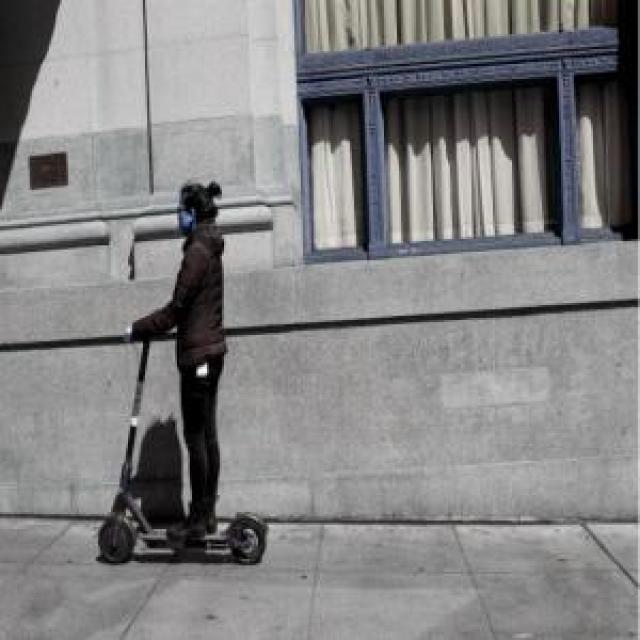

1/1 [==============================] - 0s 33ms/step
True Label: Helmet, Predicted Label: NoHelmet
Helmet: 21.71%
NoHelmet: 78.29%
예측 실패한 이미지 출력


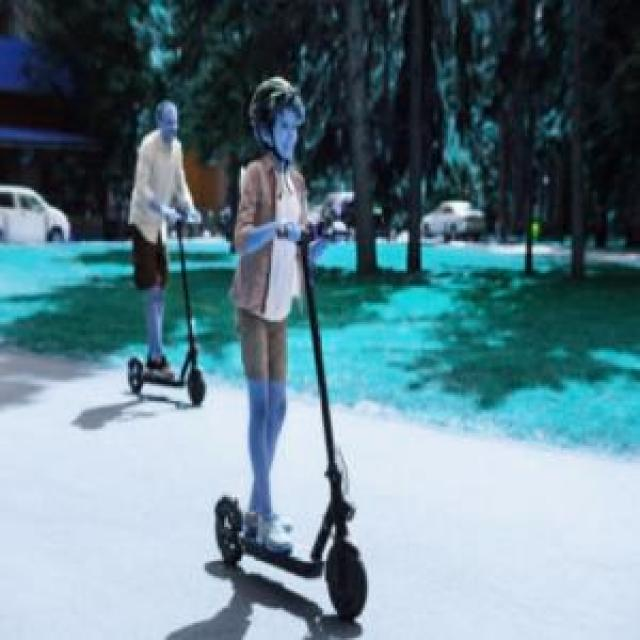

1/1 [==============================] - 0s 35ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 21.71%
NoHelmet: 78.29%
1/1 [==============================] - 0s 23ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 99.99%
NoHelmet: 0.01%
1/1 [==============================] - 0s 22ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.28%
NoHelmet: 99.72%
1/1 [==============================] - 0s 25ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.00%
NoHelmet: 100.00%
1/1 [==============================] - 0s 22ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 100.00%
NoHelmet: 0.00%
1/1 [==============================] - 0s 23ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.01%
NoHelmet: 99.99%
1/1 [==============================] - 0s 25ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.00%
NoHelmet: 100.00%
1/1 [==============================] - 0s 24ms/step
True Label: NoHelmet, Predicted Lab

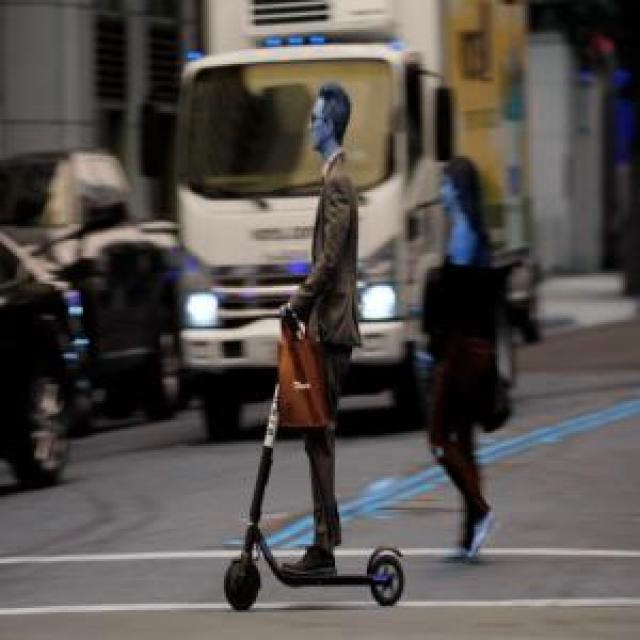

1/1 [==============================] - 0s 23ms/step
True Label: NoHelmet, Predicted Label: Helmet
Helmet: 100.00%
NoHelmet: 0.00%
예측 실패한 이미지 출력


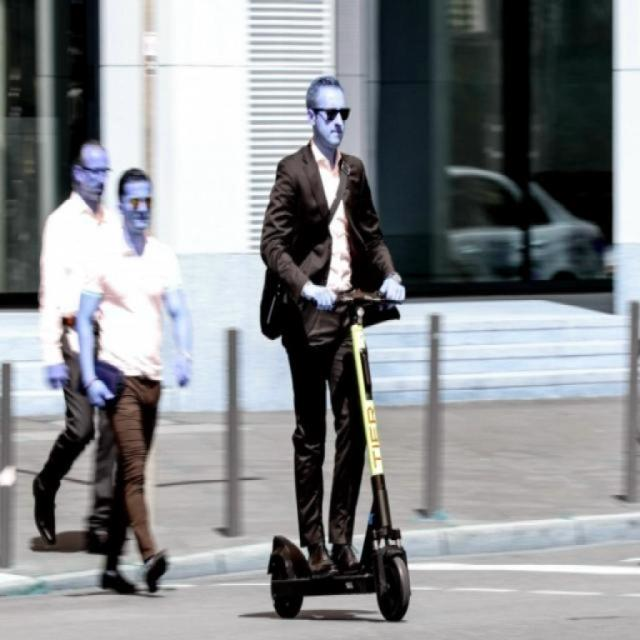

1/1 [==============================] - 0s 24ms/step
True Label: Helmet, Predicted Label: NoHelmet
Helmet: 45.75%
NoHelmet: 54.17%
예측 실패한 이미지 출력


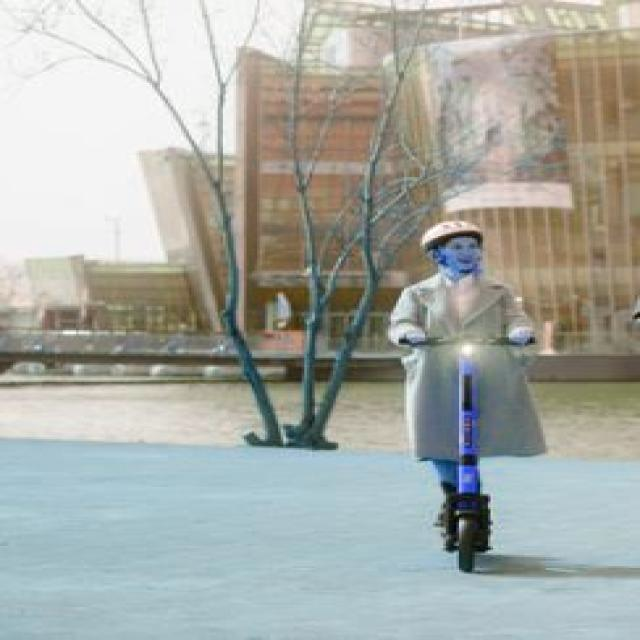

1/1 [==============================] - 0s 24ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 18.72%
NoHelmet: 81.28%
1/1 [==============================] - 0s 21ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 99.99%
NoHelmet: 0.01%
1/1 [==============================] - 0s 23ms/step
True Label: NoHelmet, Predicted Label: Helmet
Helmet: 100.00%
NoHelmet: 0.00%
예측 실패한 이미지 출력


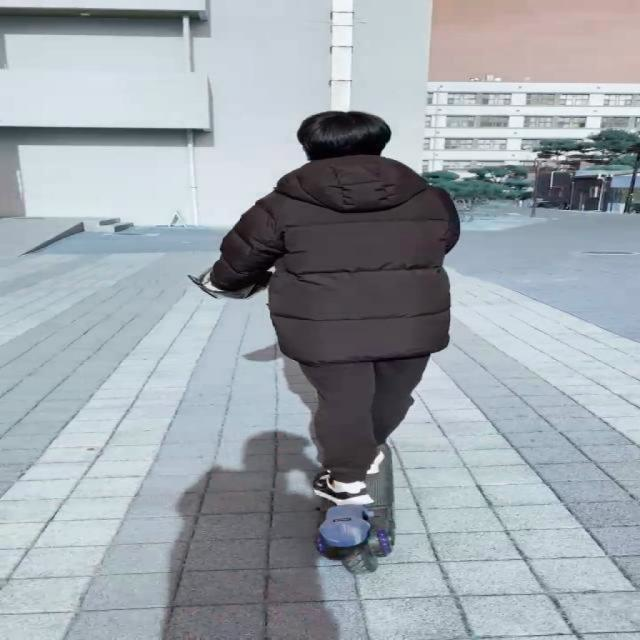

1/1 [==============================] - 0s 22ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 1.43%
NoHelmet: 98.57%
1/1 [==============================] - 0s 36ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 98.75%
NoHelmet: 1.25%
1/1 [==============================] - 0s 33ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.00%
NoHelmet: 100.00%
1/1 [==============================] - 0s 33ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.00%
NoHelmet: 100.00%
1/1 [==============================] - 0s 32ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.13%
NoHelmet: 99.87%
1/1 [==============================] - 0s 35ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 97.88%
NoHelmet: 2.12%
1/1 [==============================] - 0s 48ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 97.88%
NoHelmet: 2.12%
1/1 [==============================] - 0s 42ms/step
True Label: Helmet, Predicted Label: Helm

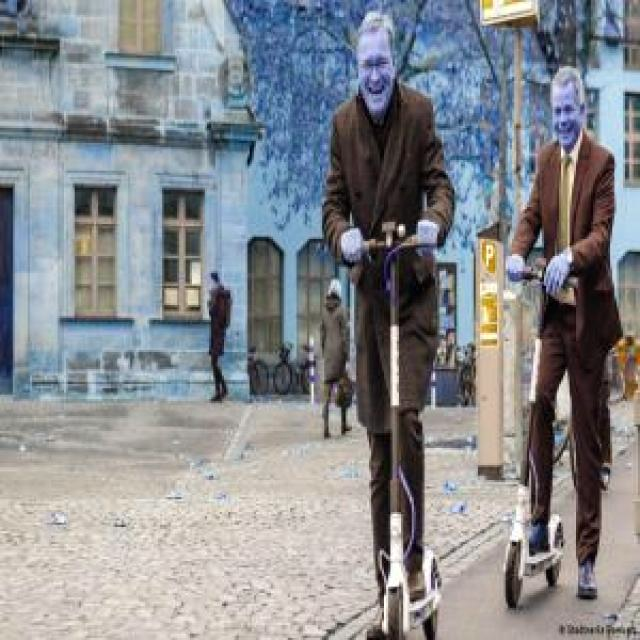

1/1 [==============================] - 0s 39ms/step
True Label: NoHelmet, Predicted Label: Helmet
Helmet: 98.20%
NoHelmet: 1.80%
예측 실패한 이미지 출력


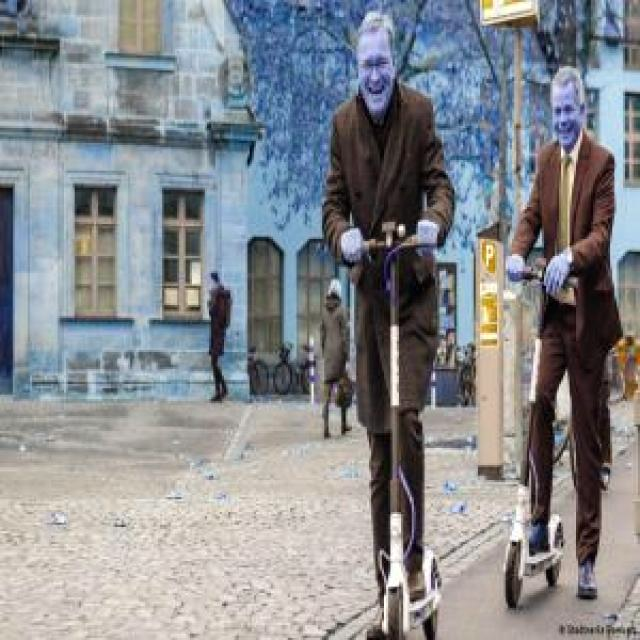

1/1 [==============================] - 0s 43ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 98.46%
NoHelmet: 1.54%
1/1 [==============================] - 0s 23ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 59.68%
NoHelmet: 40.32%
1/1 [==============================] - 0s 32ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 59.68%
NoHelmet: 40.32%
1/1 [==============================] - 0s 22ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 100.00%
NoHelmet: 0.00%
1/1 [==============================] - 0s 23ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.03%
NoHelmet: 99.97%
1/1 [==============================] - 0s 30ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 1.63%
NoHelmet: 98.37%
1/1 [==============================] - 0s 24ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 100.00%
NoHelmet: 0.00%
1/1 [==============================] - 0s 49ms/step
True Label: Helmet, Predicted Label: Helmet
Hel

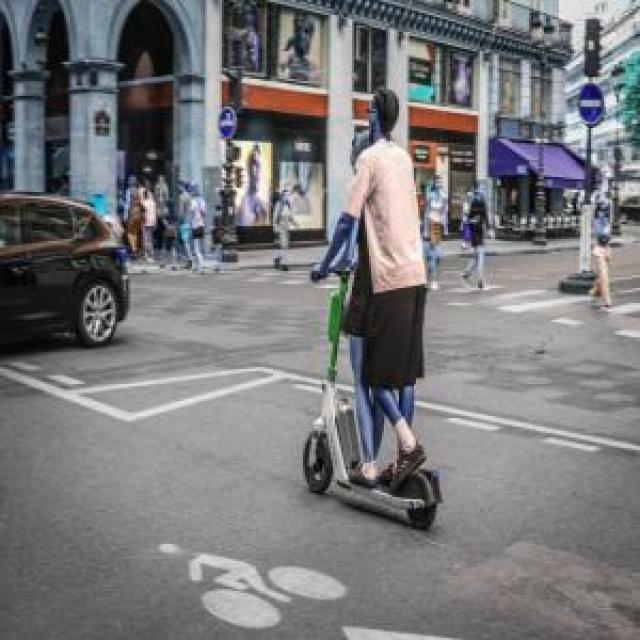

1/1 [==============================] - 0s 22ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.00%
NoHelmet: 100.00%
1/1 [==============================] - 0s 37ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
Helmet: 0.00%
NoHelmet: 100.00%
1/1 [==============================] - 0s 23ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 99.51%
NoHelmet: 0.49%
1/1 [==============================] - 0s 21ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 92.66%
NoHelmet: 7.34%
1/1 [==============================] - 0s 32ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 92.66%
NoHelmet: 7.34%
1/1 [==============================] - 0s 33ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 92.66%
NoHelmet: 7.34%
1/1 [==============================] - 0s 32ms/step
True Label: Helmet, Predicted Label: Helmet
Helmet: 92.66%
NoHelmet: 7.34%
1/1 [==============================] - 0s 24ms/step
True Label: NoHelmet, Predicted Label: NoHelmet
H

In [34]:
from tensorflow.keras.applications.mobilenet_v3 import preprocess_input
from google.colab.patches import cv2_imshow
import json
import cv2
import numpy as np
from tensorflow.keras.models import load_model

# 테스트 데이터 JSON 파일 로드
with open("/content/drive/MyDrive/DataV9/test/_annotations.coco.json", 'r') as f:
    test_coco_data = json.load(f)

# 테스트 이미지 경로
test_image_directory = "/content/drive/MyDrive/DataV9/test/test"

# 저장된 모델 로드 (MobileNetV3)
loaded_model = load_model("/content/drive/MyDrive/saved_model/trained_model(MobileNetV3).h5")

# JSON 파일 내 categories에서 클래스 라벨 정보 추출
# 클래스 레이블 0 은 분류에 무의미한 정보이므로 제외
class_labels_json = {
    category["id"]: category["name"]
    for category in test_coco_data["categories"]
    if category["id"] != 0  # "id"가 0인 경우는 제외
}

# 정확도 계산을 위한 변수 초기화
total_images = len(test_coco_data["images"])
correct_predictions = 0

# 테스트 이미지에 대한 예측과 정확도 계산
for entry in test_coco_data["annotations"]:
    image_id = entry["image_id"]
    image_filename = test_coco_data["images"][image_id]["file_name"]
    image_path = os.path.join(test_image_directory, image_filename)

    # 이미지 로드 및 전처리
    original_image = cv2.imread(image_path)
    if original_image is None:
        print(f"에러: 이미지를 불러올 수 없습니다. 이미지 경로: {image_path}")
        continue

    original_image = cv2.cvtColor(original_image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(original_image, (224, 224))
    image = preprocess_input(image.astype(np.float32))

    # 모델 예측
    predictions = loaded_model.predict(np.expand_dims(image, axis=0))[0]

    # 예측 결과와 실제 레이블 비교하여 정확도 확인
    true_label = entry["category_id"]
    predicted_label = np.argmax(predictions)

    # 클래스 라벨 가져오기
    true_label_name = class_labels_json[true_label]
    predicted_label_name = class_labels_json[predicted_label]

    # 0에 해당하는 클래스 라벨 제외하고 출력
    if true_label != 0:
        print(f"True Label: {true_label_name}, Predicted Label: {predicted_label_name}")

        # 바운딩 박스 차이 및 신뢰도 출력
        for label_id, prob in enumerate(predictions):
            if label_id != 0:  # 클래스 라벨이 0이 아닌 경우에만 출력
                label_name = class_labels_json.get(label_id, "Unknown")
                print(f"{label_name}: {prob * 100:.2f}%")

        # 예측에 실패한 경우 이미지 출력
        if true_label != predicted_label:
            print("예측 실패한 이미지 출력")
            cv2_imshow(original_image)




36 개 test 에 대해서 9개 오차
75% 의 acc 를 보여주고 있다.
특징 :: 2명이상 타면 인식 못한다